In [4]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:41:10_Pacific_Daylight_Time_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0


In [141]:
from mmengine.utils import get_git_hash
from mmengine.utils.dl_utils import collect_env as collect_base_env

import mmdet


def collect_env():
    """Collect the information of the running environments."""
    env_info = collect_base_env()
    env_info['MMDetection'] = f'{mmdet.__version__}+{get_git_hash()[:7]}'
    return env_info


if __name__ == '__main__':
    for name, val in collect_env().items():
        print(f'{name}: {val}')

sys.platform: win32
Python: 3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]
CUDA available: True
MUSA available: False
numpy_random_seed: 2147483648
GPU 0: NVIDIA GeForce GTX 1650 Ti
CUDA_HOME: C:\Program Files\NVIDIA GPU Computing Toolkit\CUDA\v11.8
NVCC: Cuda compilation tools, release 11.8, V11.8.89
MSVC: n/a, reason: fileno
PyTorch: 2.3.0
PyTorch compiling details: PyTorch built with:
  - C++ Version: 201703
  - MSVC 192930151
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.3.6 (Git Hash 86e6af5974177e513fd3fee58425e1063e7f1361)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_61,code=sm_61;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,co

In [1]:
!mkdir /checkpoints/rtmdet
!mim download mmdet --config rtmdet_tiny_8xb32-300e_coco --dest /checkpoints/rtmdet

The syntax of the command is incorrect.


processing rtmdet_tiny_8xb32-300e_coco...
downloading ---------------------------------------- 0.0/54.9 MiB ? eta -:--:--
downloading --------------------------------- 0.0/54.9 MiB 1.1 MB/s eta 0:00:55
downloading --------------------------------- 0.1/54.9 MiB 1.6 MB/s eta 0:00:37
downloading --------------------------------- 0.3/54.9 MiB 2.5 MB/s eta 0:00:24
downloading --------------------------------- 0.6/54.9 MiB 3.3 MB/s eta 0:00:18
downloading  -------------------------------- 0.9/54.9 MiB 3.9 MB/s eta 0:00:15
downloading  -------------------------------- 1.3/54.9 MiB 7.3 MB/s eta 0:00:08
downloading  -------------------------------- 1.3/54.9 MiB 7.3 MB/s eta 0:00:08
downloading - ------------------------------- 1.8/54.9 MiB 7.3 MB/s eta 0:00:08
downloading - ------------------------------- 2.2/54.9 MiB 7.3 MB/s eta 0:00:08
downloading - ------------------------------- 2.5/54.9 MiB 8.2 MB/s eta 0:00:07
downloading - ------------------------------- 2.9/54.9 MiB 8.2 MB/s eta 0:00:0

In [14]:
config_aquarium = """
# Inherit and overwrite part of the config based on this config
_base_ = 'C:/projects/marine_detection/mmdetection/configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py'

data_root = 'C:/projects/marine_detection/dataset/' # dataset root

train_batch_size_per_gpu = 4
train_num_workers = 2

max_epochs = 100
base_lr = 0.00008

metainfo = {
    'classes': ('creatures','fish','jellyfish','penguin','shark','puffin','stingray','starfish'),
    'palette': [
        (255, 0, 0),        #creatures
        (0, 255, 0),        # Fish
        (255, 105, 180),    # Jellyfish
        (0, 0, 255),        # Penguin
        (255, 165, 0),      # Shark
        (255, 192, 203),    # Puffin
        (128, 0, 128),      # Stingray
        (255, 215, 0),      # Starfish
    ]
}

train_pipeline = [
    dict(type='LoadImageFromFile', backend_args=None),
    dict(type='LoadAnnotations', with_bbox=True),
    dict(type='Resize', scale=(640, 640), keep_ratio=True),  # Add Resize step
    dict(type='RandomFlip', prob=0.5),
    dict(type='Normalize', mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True),
    dict(type='PackDetInputs')  # Ensure inputs are packed
]

val_pipeline = [
    dict(type='LoadImageFromFile', backend_args=None),
    dict(type='Resize', scale=(640, 640), keep_ratio=True),  # Add Resize step
    dict(type='Normalize', mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True),
    dict(type='PackDetInputs', meta_keys=('img_id', 'img_path', 'ori_shape', 'img_shape', 'scale_factor'))
]

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='C:/projects/marine_detection/dataset/train/'),
        ann_file=data_root+'train/_annotations.coco.json',
        pipeline=train_pipeline
    )
)

val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='C:/projects/marine_detection/dataset/valid/'),
        ann_file=data_root+'valid/_annotations.coco.json',
        pipeline=val_pipeline
    )
)

test_dataloader = val_dataloader

val_evaluator = dict(ann_file=data_root + 'valid/_annotations.coco.json')
test_evaluator = val_evaluator

model = dict(bbox_head=dict(num_classes=8))

# Learning rate schedule
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=10),
    dict(
        # Use cosine annealing from 10 to 20 epochs
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]

# Optimizer
optim_wrapper = dict(
    _delete_=True,
    type='OptimWrapper',
    optimizer=dict(type='AdamW', lr=base_lr, weight_decay=0.05),
    paramwise_cfg=dict(
        norm_decay_mult=0, bias_decay_mult=0, bypass_duplicate=True),
)

# Default hooks configuration
default_hooks = dict(
    checkpoint=dict(
        interval=5,
        max_keep_ckpts=2,  # Keep only the latest 2 checkpoints
        save_best='auto'
    ),
    logger=dict(type='LoggerHook', interval=5))

# Load pretrained weights
load_from = 'C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

# Training configuration
train_cfg = dict(
    type='EpochBasedTrainLoop',
    max_epochs=max_epochs,
    val_interval=1,
)

# Visualization configuration
visualizer = dict(vis_backends=[
    dict(type='LocalVisBackend'),
    dict(type='TensorboardVisBackend')
])
"""

# Save configuration
with open('C:/projects/marine_detection/checkpoints/rtmdet_aug/rtmdet_tiny_aug_aquarium.py', 'w') as f:
    f.write(config_aquarium)


In [15]:
import torch
torch.cuda.empty_cache()

In [16]:
!python mmdetection/tools/train.py checkpoints/rtmdet_aug/rtmdet_tiny_aug_aquarium.py

09/09 16:47:09 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 17076323
    GPU 0: NVIDIA GeForce GTX 1650 Ti
    CUDA_HOME: C:\Program Files\NVIDIA GPU Computing Toolkit\CUDA\v11.8
    NVCC: Cuda compilation tools, release 11.8, V11.8.89
    MSVC: Microsoft (R) C/C++ Optimizing Compiler Version 19.34.31937 for x64
    GCC: n/a
    PyTorch: 2.3.0
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 201703
  - MSVC 192930151
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.3.6 (Git Hash 86e6af5974177e513fd3fee58425e1063e7f1361)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
  

c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


09/09 17:27:58 - mmengine - INFO - bbox_mAP_copypaste: 0.350 0.593 0.341 0.120 0.232 0.460
09/09 17:27:58 - mmengine - INFO - Epoch(val) [36][26/26]    coco/bbox_mAP: 0.3500  coco/bbox_mAP_50: 0.5930  coco/bbox_mAP_75: 0.3410  coco/bbox_mAP_s: 0.1200  coco/bbox_mAP_m: 0.2320  coco/bbox_mAP_l: 0.4600  data_time: 0.0156  time: 0.1669
09/09 17:27:58 - mmengine - INFO - The previous best checkpoint c:\projects\marine_detection\work_dirs\rtmdet_tiny_aug_aquarium\best_coco_bbox_mAP_epoch_24.pth is removed
09/09 17:27:59 - mmengine - INFO - The best checkpoint with 0.3500 coco/bbox_mAP at 36 epoch is saved to best_coco_bbox_mAP_epoch_36.pth.
09/09 17:28:02 - mmengine - INFO - Epoch(train)  [37][  5/112]  base_lr: 8.0000e-05 lr: 8.0000e-05  eta: 0:56:44  time: 0.2682  data_time: 0.0048  memory: 1445  loss: 0.5282  loss_cls: 0.2267  loss_bbox: 0.3016
09/09 17:28:03 - mmengine - INFO - Epoch(train)  [37][ 10/112]  base_lr: 8.0000e-05 lr: 8.0000e-05  eta: 0:56:39  time: 0.2670  data_time: 0.0048 

In [ ]:
from mmdet.apis import DetInferencer
import glob
import os

# Choose to use a config
config = 'C:/projects/marine_detection/checkpoints/rtmdet_aug/rtmdet_tiny_aug_aquarium.py'

# Setup a checkpoint file to load
checkpoint = glob.glob('C:/projects/marine_detection/work_dirs/rtmdet_tiny_aug_aquarium/best_coco*.pth')[0]

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(config, checkpoint, device)

# Define the test images folder and output directory
test_images_folder = 'C:/projects/marine_detection/dataset/test'
output_dir = 'C:/projects/marine_detection/test_results/rtmdet_tiny_augment'

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Get all images from the test folder
image_paths = glob.glob(os.path.join(test_images_folder, '*.jpg'))  # Adjust the extension if needed (e.g., '*.png')

# Loop through each image and run inference
for img_path in image_paths:
    print(f'Processing {img_path}...')
    result = inferencer(img_path, out_dir=output_dir)

print("Inference complete for all test images.")

In [4]:
!python C:/projects/marine_detection/mmdetection/tools/test.py \
   C:/projects/marine_detection/checkpoints/rtmdet_aug/rtmdet_tiny_aug_aquarium.py \
    C:/projects/marine_detection/work_dirs/rtmdet_tiny_aug_aquarium/best_coco_bbox_mAP_epoch_46.pth \
    --out C:/projects/marine_detection/work_dirs/rtmdet_tiny_aug_aquarium/results.pkl \
    --show

09/09 23:04:36 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1569980311
    GPU 0: NVIDIA GeForce GTX 1650 Ti
    CUDA_HOME: C:\Program Files\NVIDIA GPU Computing Toolkit\CUDA\v11.8
    NVCC: Cuda compilation tools, release 11.8, V11.8.89
    MSVC: Microsoft (R) C/C++ Optimizing Compiler Version 19.34.31937 for x64
    GCC: n/a
    PyTorch: 2.3.0
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 201703
  - MSVC 192930151
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.3.6 (Git Hash 86e6af5974177e513fd3fee58425e1063e7f1361)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2


c:\projects\marine_detection\mmdetection\mmdet\engine\hooks\visualization_hook.py:68: UserWarning: The show is True, it means that only the prediction results are visualized without storing data, so vis_backends needs to be excluded.
  warnings.warn('The show is True, it means that only '
c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.mes

In [5]:
!python C:/projects/marine_detection/mmdetection/tools/analysis_tools/eval_metric.py \
  C:/projects/marine_detection/checkpoints/rtmdet_aug/rtmdet_tiny_aug_aquarium.py \
  C:/projects/marine_detection/work_dirs/rtmdet_tiny_aug_aquarium/results.pkl \
  --cfg-options eval=bbox

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
09/09 23:07:13 - mmengine - INFO - Evaluating bbox...
Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.30s).
Accumulating evaluation results...
DONE (t=0.23s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.366
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.609
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.363
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.109
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.261
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.474
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.190
 Average

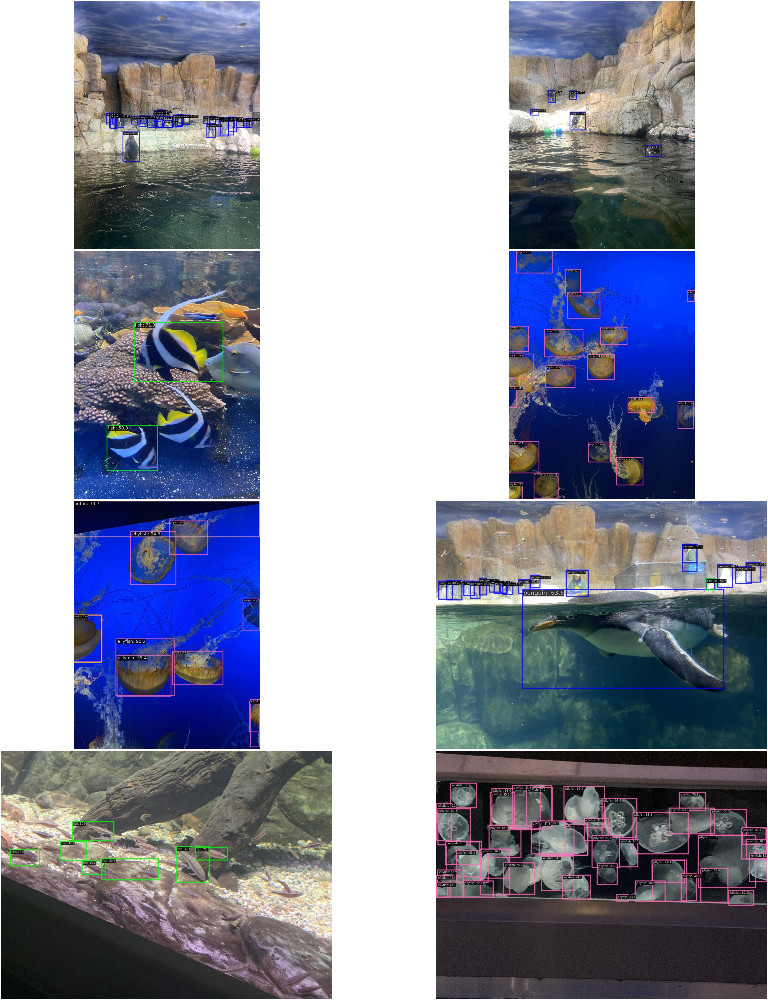

In [8]:
import os
import glob
import matplotlib.pyplot as plt
import cv2  # OpenCV for image loading

# Define the path to the folder containing images
image_folder = 'C:/projects/marine_detection/test_results/rtmdet_tiny_augment/vis'  # Adjust path as needed
image_paths = glob.glob(os.path.join(image_folder, '*.jpg'))  # Adjust the extension if needed


image_paths = image_paths[:8]

# Set up the figure size and layout (5 rows, 4 columns)
fig, axes = plt.subplots(4, 2, figsize=(80,80))  # Adjust size as needed

# Flatten axes array for easy indexing
axes = axes.flatten()

# Loop through images and display them in the grid
for i, img_path in enumerate(image_paths):
    # Load the image using OpenCV
    img = cv2.imread(img_path)
    # Convert the image from BGR (OpenCV format) to RGB (Matplotlib format)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image on the i-th subplot
    axes[i].imshow(img)
    # axes[i].set_title(os.path.basename(img_path))
    axes[i].axis('off')  # Hide axis labels

# Hide any unused subplots if there are fewer than 20 images
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust layout and display the figure
plt.tight_layout()
plt.show()